In [1]:
TRAIN = '/kaggle/input/fruit-vegetable/labeled/train'
TEST = '/kaggle/input/fruit-vegetable/labeled/val'

We want to use image embeddings for both EDA and classification, so let's introduce some code that will get image embeddings using ResNeXt without fine-tuning.

In [2]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth
100%|██████████| 95.8M/95.8M [00:00<00:00, 167MB/s]


Now let's load up all of our data. We have a lot of classes and not a lot of instances per class, so we will be patient and load it all, even if it takes forever (less than 15 minutes).

In [3]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from os.path import isdir
from PIL import Image

THUMBNAIL_SIZE = (64, 64)

def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGB').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def get_picture_from_glob(arg: str, tag: str,) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[tag, basename(input_file), embed(model=model, filename=input_file), png(filename=input_file)],
                        index=['tag', 'name', 'value', 'png'] )
        for index, input_file in enumerate(list(iglob(pathname=arg)))]
    print('encoded {} rows of {}  in {}'.format(len(result), tag, arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*') if isdir(folder)}
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in train_dict.items()]))
test_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TEST + '/*') if isdir(folder)}
test_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in test_dict.items()]))
print('done in {}'.format(arrow.now() - time_start))

encoded 89 rows of capsicum  in 0:00:18.192171
encoded 91 rows of sweetcorn  in 0:00:17.485989
encoded 69 rows of orange  in 0:00:17.495578


/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


encoded 92 rows of tomato  in 0:00:19.816008
encoded 98 rows of turnip  in 0:00:18.455218
encoded 68 rows of ginger  in 0:00:13.780314
encoded 81 rows of raddish  in 0:00:13.335756
encoded 79 rows of pomegranate  in 0:00:18.847001
encoded 99 rows of pineapple  in 0:00:30.408989
encoded 88 rows of jalepeno  in 0:00:18.056066
encoded 68 rows of apple  in 0:00:17.460933
encoded 82 rows of carrot  in 0:00:15.840870
encoded 97 rows of lettuce  in 0:00:24.520520
encoded 90 rows of bell pepper  in 0:00:22.800587
encoded 84 rows of eggplant  in 0:00:18.126243
encoded 88 rows of beetroot  in 0:00:17.632314
encoded 88 rows of kiwi  in 0:00:17.638711
encoded 89 rows of pear  in 0:00:17.359086
encoded 92 rows of cabbage  in 0:00:19.190572
encoded 79 rows of cauliflower  in 0:00:15.700309
encoded 83 rows of paprika  in 0:00:15.727390
encoded 82 rows of lemon  in 0:00:20.861383
encoded 69 rows of sweetpotato  in 0:00:14.668740
encoded 100 rows of grapes  in 0:00:26.370337
encoded 94 rows of cucumber

Are our classes balanced? Sort of. Not perfectly, but not badly.

In [4]:
train_df['tag'].value_counts(normalize=True).to_frame().T

tag,peas,grapes,pineapple,turnip,soy beans,lettuce,spinach,onion,cucumber,garlic,...,lemon,raddish,pomegranate,cauliflower,potato,banana,sweetpotato,orange,apple,ginger
proportion,0.032103,0.032103,0.031782,0.031461,0.03114,0.03114,0.03114,0.030177,0.030177,0.029535,...,0.026324,0.026003,0.025361,0.025361,0.024719,0.024077,0.022151,0.022151,0.02183,0.02183


Let's use TSNE to add x/y coordinates based on our image embeddings so we can make an interactive exploratory plot. The tighter and more distinct our clusters are, the better we expect our model accuracy to be, provided the clusters align with our classes.

In [5]:
from sklearn.manifold import TSNE

train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))
test_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
test_df[['x', 'y']] = test_reducer.fit_transform(X=test_df['value'].apply(func=pd.Series))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 3115 samples in 0.021s...
[t-SNE] Computed neighbors for 3115 samples in 0.928s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3115
[t-SNE] Computed conditional probabilities for sample 2000 / 3115
[t-SNE] Computed conditional probabilities for sample 3000 / 3115
[t-SNE] Computed conditional probabilities for sample 3115 / 3115
[t-SNE] Mean sigma: 2.312883
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.967026
[t-SNE] KL divergence after 1000 iterations: 1.130553
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 351 samples in 0.002s...
[t-SNE] Computed neighbors for 351 samples in 0.022s...
[t-SNE] Computed conditional probabilities for sample 351 / 351
[t-SNE] Mean sigma: 4.475444
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.873154
[t-SNE] KL divergence after 1000 iterations: 0.639687


Let's plot.

In [6]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'tag', 'x', 'y']].sample(n=min(len(train_df) - 1, 10000)))
factor_count = max(train_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=train_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: fruit and vegetables (training data)', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=8, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? We see a lot of fairly distinct clusters, with some mixing (corn is hard to tell from sweet corn) and a fair number of difficult cases. We might be cautiously optimistic about making an accurate model. Let's build a model and see what we get.

In [7]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score

logreg = LogisticRegression(max_iter=10000, tol=1e-12).fit(train_df['value'].apply(func=pd.Series), train_df['tag'])
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series)))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series)))))
print(classification_report(zero_division=0.0, y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series))))

model fit in 525 iterations
accuracy: 0.9658
f1: 0.9655
               precision    recall  f1-score   support

        apple       0.90      0.90      0.90        10
       banana       1.00      0.78      0.88         9
     beetroot       1.00      1.00      1.00        10
  bell pepper       0.78      0.78      0.78         9
      cabbage       1.00      1.00      1.00        10
     capsicum       0.80      0.80      0.80        10
       carrot       0.90      1.00      0.95         9
  cauliflower       1.00      1.00      1.00        10
chilli pepper       1.00      1.00      1.00         9
         corn       0.89      0.80      0.84        10
     cucumber       1.00      1.00      1.00        10
     eggplant       1.00      1.00      1.00        10
       garlic       1.00      1.00      1.00        10
       ginger       1.00      1.00      1.00        10
       grapes       1.00      1.00      1.00         9
     jalepeno       1.00      1.00      1.00         9
        

An f1 of 0.97 isn't bad. Let's have a look at our model probabilities.

<Axes: xlabel='probability', ylabel='Count'>

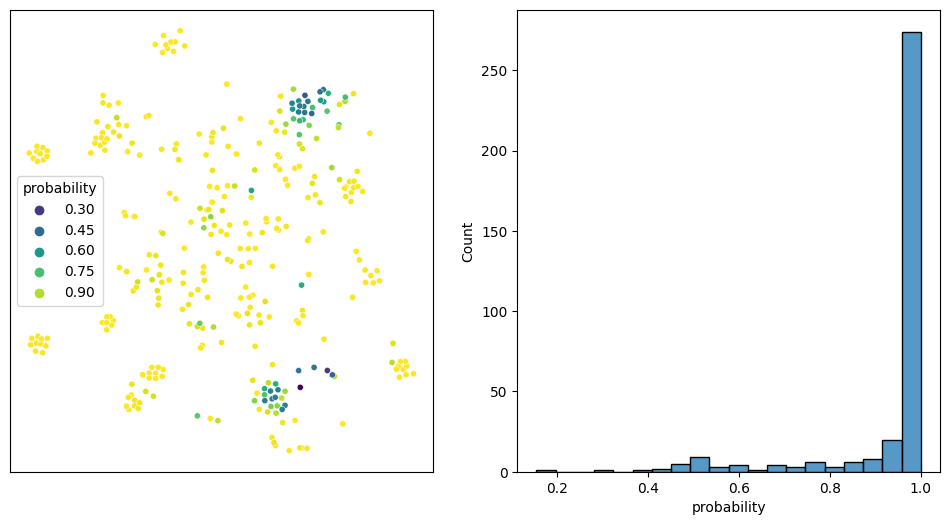

In [8]:
import matplotlib.pyplot as plt
import warnings
from seaborn import histplot
from seaborn import scatterplot

warnings.filterwarnings('ignore', category=FutureWarning, module='seaborn')

plot_df = test_df[['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=test_df['value'].apply(func=pd.Series)), axis=1)

plt, ax = plt.subplots(ncols=2, figsize=(12, 6))
scatterplot(ax=ax[0], data=plot_df, x='x', y='y', hue='probability', palette='viridis', s=20)
ax[0].set(xlabel=None)
ax[0].set(ylabel=None)
ax[0].set(xticklabels=[])
ax[0].set(yticklabels=[])
ax[0].tick_params(axis='both', which='both', length=0)
histplot(ax=ax[1], data=plot_df, x='probability', bins=20)

Our model probabilities are mostly pretty high, with a couple of clusters of doubt. Let's revisit our scatter plot above, but for our test data, and have a look at those clusters.

In [9]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(test_df[['png', 'tag', 'x', 'y']].sample(n=min(len(test_df) - 1, 10000)))
factor_count = max(test_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=test_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: fruit and vegetables (test data)', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=8, color=mapper)
show(plot_figure)

Loading BokehJS ...

Not surprisingly, our low-confidence clusters are corn vs. sweet corn and capsicum vs. bell peppers (plus some chili peppers). Google says corn and sweet corn are the same thing at different ages, and capsicum/bell peppers are the same thing. It might make sense to just merge these classes pairwise and be done.